**Predicting the depth information of a scene from a single image.**
---
Applications: 3D reconstruction, augmented reality, autonomous driving, and
robotics.




In [1]:
! pip install -q -U transformers

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 43.7/43.7 kB 2.0 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 9.5/9.5 MB 12.2 MB/s eta 0:00:00


# Depth estimation pipeline

In [2]:
from transformers import pipeline
import torch

device = "cuda" if torch.cuda.is_available() else "cpu"
model_name = "depth-anything/Depth-Anything-V2-base-hf"
pipe = pipeline("depth-estimation", model=model_name, device=device)

/usr/local/lib/python3.10/dist-packages/huggingface_hub/utils/_token.py:89: UserWarning: 
The secret `HF_TOKEN` does not exist in your Colab secrets.
To authenticate with the Hugging Face Hub, create a token in your settings tab (https://huggingface.co/settings/tokens), set it as secret in your Google Colab and restart your session.
You will be able to reuse this secret in all of your notebooks.
Please note that authentication is recommended but still optional to access public models or datasets.
  warnings.warn(


config.json:   0%|          | 0.00/953 [00:00<?, ?B/s]

model.safetensors:   0%|          | 0.00/390M [00:00<?, ?B/s]

preprocessor_config.json:   0%|          | 0.00/775 [00:00<?, ?B/s]

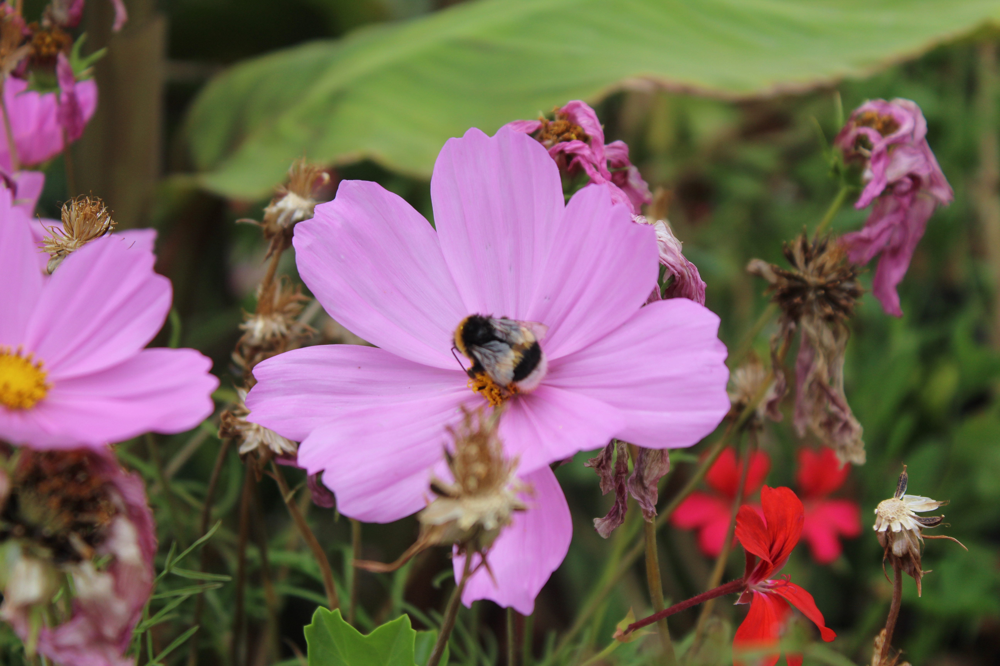

In [3]:
from PIL import Image
import requests

url = "https://huggingface.co/datasets/huggingface/documentation-images/resolve/main/bee.jpg"
image = Image.open(requests.get(url, stream=True).raw)
image

In [4]:
predictions = pipe(image)
predictions

{'predicted_depth': tensor([[[1.6979, 1.5721, 1.6151,  ..., 1.4559, 1.4758, 1.3637],
          [1.6578, 1.6692, 1.7363,  ..., 1.5056, 1.5025, 1.5146],
          [1.7556, 1.7824, 1.9073,  ..., 1.5150, 1.5157, 1.5202],
          ...,
          [4.3357, 4.2939, 4.2907,  ..., 0.9727, 0.9758, 0.9745],
          [4.3716, 4.2515, 4.3286,  ..., 0.9676, 0.9715, 0.9770],
          [4.4290, 4.2830, 4.2862,  ..., 0.9526, 0.9332, 0.9949]]]),
 'depth': <PIL.Image.Image image mode=L size=5184x3456>}

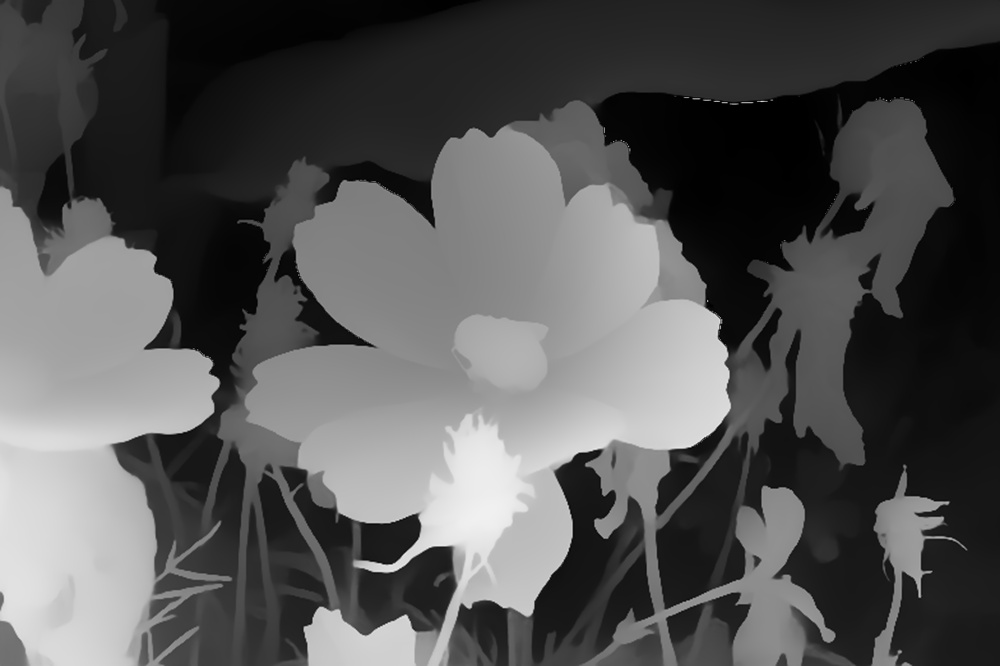

In [5]:
predictions["depth"]

# Depth estimation without pipeline

In [6]:
from transformers import AutoImageProcessor, AutoModelForDepthEstimation

checkpoint = "Intel/zoedepth-nyu-kitti"

image_processor = AutoImageProcessor.from_pretrained(checkpoint)
model = AutoModelForDepthEstimation.from_pretrained(checkpoint).to(device)

preprocessor_config.json:   0%|          | 0.00/723 [00:00<?, ?B/s]

config.json:   0%|          | 0.00/2.23k [00:00<?, ?B/s]

model.safetensors:   0%|          | 0.00/1.38G [00:00<?, ?B/s]

In [7]:
pixel_values = image_processor(image, return_tensors="pt").pixel_values.to(device)

In [8]:
import torch

with torch.no_grad():
    outputs = model(pixel_values)

In [9]:
import numpy as np
import torch.nn.functional as F

predicted_depth = outputs.predicted_depth.unsqueeze(dim=1)
height, width = pixel_values.shape[2:]

height_padding_factor = width_padding_factor = 3
pad_h = int(np.sqrt(height/2) * height_padding_factor)
pad_w = int(np.sqrt(width/2) * width_padding_factor)

if predicted_depth.shape[-2:] != pixel_values.shape[-2:]:
   predicted_depth = F.interpolate(predicted_depth, size= (height, width), mode='bicubic', align_corners=False)

if pad_h > 0:
  predicted_depth = predicted_depth[:, :, pad_h:-pad_h,:]
if pad_w > 0:
  predicted_depth = predicted_depth[:, :, :, pad_w:-pad_w]

In [10]:
import matplotlib

def colorize(value, vmin=None, vmax=None, cmap='gray_r', invalid_val=-99, invalid_mask=None, background_color=(128, 128, 128, 255), gamma_corrected=False, value_transform=None):
    if isinstance(value, torch.Tensor):
        value = value.detach().cpu().numpy()

    value = value.squeeze()
    if invalid_mask is None:
        invalid_mask = value == invalid_val
    mask = np.logical_not(invalid_mask)

    # normalize
    vmin = np.percentile(value[mask],2) if vmin is None else vmin
    vmax = np.percentile(value[mask],85) if vmax is None else vmax
    if vmin != vmax:
        value = (value - vmin) / (vmax - vmin)  # vmin..vmax
    else:
        value = value * 0.



    value[invalid_mask] = np.nan
    cmapper = matplotlib.colormaps.get_cmap(cmap)
    if value_transform:
        value = value_transform(value)
    value = cmapper(value, bytes=True)  # (nxmx4)


    img = value[...]
    img[invalid_mask] = background_color

    if gamma_corrected:
        img = img / 255
        img = np.power(img, 2.2)
        img = img * 255
        img = img.astype(np.uint8)
    return img

In [11]:
result = colorize(predicted_depth.cpu().squeeze().numpy())

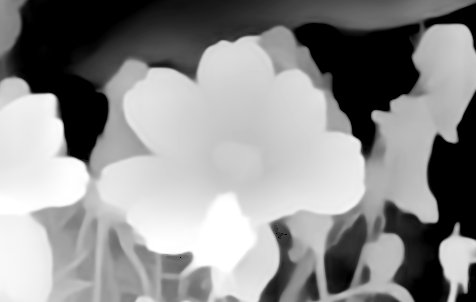

In [12]:
Image.fromarray(result)